# Saildrone 2019 Antarctica Circumnavigation
------------------------------------------------------------------------
## A Data Visualization Project
Disclaimer:
This work is not a scientific research study based on the data collected during the Saildrone mission in Antarctica in 2019.

This Jupyter notebook is not the end-product. It is only shared to present the code used to generate the visualizations and calculations published in the document presentation.


## The Libraries
Outside classic python libraries, the below python libraries are used:
* __xarray__ is used to read the NetCDF ".nc" files
* __cartopy__ and __geoviews__ are used to produce the orthographic map visualization
* __altair__ is used to produce traditional visualizations
* __scikit-learn__ is used to compute the haversine distance between observations

In [1]:
import numpy as np
import pandas as pd
import geoviews as gv
import geoviews.tile_sources as gts
import xarray as xr
import altair as alt

from datetime import datetime, timedelta
from math import radians
from sklearn.metrics.pairwise import haversine_distances
from cartopy import crs as ccrs

In [29]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

## The Data
The datasets are not provided here. To run this notebook, please download them directly (link below) and add them in the same folder as the notebook.
### The Saildrone Dataset
The Saildrone datasets of the mission, containing the measurements for Saildrone's standard atmospheric and oceanographic measurements is available here: https://data.saildrone.com/data/sets/antarctica-circumnavigation-2019/overview

In [3]:
saildrone_file_1h = "saildrone-gen_5-antarctica_circumnavigation_2019-sd1020-20190119T040000-20190803T043000-60_minutes-v1.1620361273670.nc"
saildrone_file_1min = "saildrone-gen_5-antarctica_circumnavigation_2019-sd1020-20190119T040000-20190803T043000-1_minutes-v1.1620360815446.nc"

In [4]:
ds_saildrone_1h = xr.open_dataset(saildrone_file_1h).load()
ds_saildrone_1min = xr.open_dataset(saildrone_file_1min).load()
# Select the dataset for this part of the analysis
ds_saildrone = ds_saildrone_1h
kdims = ['longitude', 'latitude']
gvds_saildrone = gv.Dataset(ds_saildrone, kdims=kdims)
ds_saildrone

<xarray.Dataset>
Dimensions:                         (trajectory: 1, obs: 4705)
Coordinates:
    latitude                        (trajectory, obs) float64 -46.68 ... -46.64
    longitude                       (trajectory, obs) float64 168.5 ... 168.3
    time                            (trajectory, obs) datetime64[ns] 2019-01-...
  * trajectory                      (trajectory) float32 1.02e+03
Dimensions without coordinates: obs
Data variables: (12/49)
    SOG                             (trajectory, obs) float64 1.762 ... 1.925
    COG                             (trajectory, obs) float64 119.8 ... 107.8
    HDG                             (trajectory, obs) float64 108.2 ... 95.2
    HDG_WING                        (trajectory, obs) float64 107.1 ... 107.3
    WING_ANGLE                      (trajectory, obs) float64 -1.1 -1.1 ... 9.4
    UWND_MEAN                       (trajectory, obs) float64 13.7 15.28 ... nan
    ...                              ...
    O2_SAT_RBR_MEAN                 (trajectory, obs) float64 96.29 ... 96.15
    O2_SAT_RBR_STDDEV               (trajectory, obs) float64 0.09 0.09 ... 0.05
    TEMP_O2_RBR_MEAN                (trajectory, obs) float64 15.68 ... 10.0
    TEMP_O2_RBR_STDDEV              (trajectory, obs) float64 0.002 ... 0.002
    CHLOR_RBR_MEAN                  (trajectory, obs) float64 1.505 ... 108.1
    CHLOR_RBR_STDDEV                (trajectory, obs) float64 0.0268 ... 2.292
Attributes: (12/38)
    title:                     Antarctica Circumnavigation Surface Data
    summary:                   This data set was collected from the first Sai...
    ncei_template_version:     NCEI_NetCDF_Trajectory_Template_v2.0
    Conventions:               CF-1.6, ACDD-1.3
    netcdf_version:            4.6.3
    featureType:               trajectory
    ...                        ...
    geospatial_lat_min:        -60.985408
    geospatial_lat_max:        -46.4287296
    geospatial_lat_units:      degrees_north
    geospatial_lon_min:        -179.9849984
    geospatial_lon_max:        179.9122304
    geospatial_lon_units:      degrees_east

### The NOAA Dataset
The datasets available on the Saildrone website do not include the ASVCO2 censors data.
These data are available from the NOAA website here: https://www.ncei.noaa.gov/data/oceans/ncei/ocads/data/0221912/

In [5]:
noaa_df = pd.read_csv("32DB20190119_ASV_Saildrone1020_Antarctic_Jan2019_Aug2019.csv",
                      header=4,
                      parse_dates=[["Date", "Time"]])
noaa_df.head()

,Date_Time,Mooring Name,Latitude,Longitude,xCO2 SW (wet) (umol/mol),CO2 SW QF,H2O SW (mmol/mol),xCO2 Air (wet) (umol/mol),CO2 Air QF,H2O Air (mmol/mol),...,xCO2 SW (dry) (umol/mol),xCO2 Air (dry) (umol/mol),fCO2 SW (sat) uatm,fCO2 Air (sat) uatm,dfCO2,pCO2 SW (sat) uatm,pCO2 Air (sat) uatm,dpCO2,WSPD (m/s),WSPD QF
0,2019-01-19 20:17:00,Saildrone1020_Antarctic,-47.1136,170.7967,384.1,2,2.50,402.5,2,2.49,...,385.1,403.5,371.9,389.7,-17.8,373.3,391.1,-17.8,14.7,2
1,2019-01-19 21:17:00,Saildrone1020_Antarctic,-47.1410,170.9156,372.7,2,2.54,402.0,2,2.56,...,373.7,403.0,361.0,389.4,-28.4,362.3,390.8,-28.5,17.2,2
2,2019-01-19 22:17:00,Saildrone1020_Antarctic,-47.1722,171.0097,383.7,2,2.80,401.5,2,2.81,...,384.7,402.6,371.4,388.6,-17.3,372.8,390.1,-17.3,12.0,2
3,2019-01-19 23:17:00,Saildrone1020_Antarctic,-47.2080,171.1025,382.3,2,2.87,401.4,2,2.83,...,383.4,402.5,369.9,388.3,-18.4,371.2,389.7,-18.5,15.7,2
4,2019-01-20 00:17:00,Saildrone1020_Antarctic,-47.2467,171.1973,381.0,2,2.99,400.7,2,2.99,...,382.2,401.9,368.5,387.5,-19.1,369.8,388.9,-19.1,15.3,2


## Orhtographic Map Visualization of the USV Circumnavigation

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
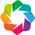

In [6]:
gv.extension( 'bokeh', 'matplotlib')
# Load Esri satellite imagery of the Earth
tiles = gts.EsriImagery()

In [7]:
# generate the points on the map of the USV positions
saildrone_points = gvds_saildrone.to(gv.Points, ['longitude', 'latitude']).opts(color="#A84B2F")
# Size the Esri tiles and their quality (zoom_level) for the output image
esri_tiles = gv.util.get_tile_rgb(tiles, bbox=(-400, -400, 400, 400), zoom_level=3)
#generate the othographic map visualization
(esri_tiles * saildrone_points).opts(width=800, height=800, projection=ccrs.Orthographic(0, -90), global_extent=True)

:Overlay
   .RGB.I    :RGB   [Longitude,Latitude]   (R,G,B)
   .Points.I :Points   [longitude,latitude]   (SOG,COG,HDG,HDG_WING,WING_ANGLE,UWND_MEAN,UWND_STDDEV,VWND_MEAN,VWND_STDDEV,WWND_MEAN,WWND_STDDEV,GUST_WND_MEAN,GUST_WND_STDDEV,WIND_MEASUREMENT_HEIGHT_MEAN,WIND_MEASUREMENT_HEIGHT_STDDEV,TEMP_AIR_MEAN,TEMP_AIR_STDDEV,RH_MEAN,RH_STDDEV,BARO_PRES_MEAN,BARO_PRES_STDDEV,PAR_AIR_MEAN,PAR_AIR_STDDEV,TEMP_IR_SEA_WING_UNCOMP_MEAN,TEMP_IR_SEA_WING_UNCOMP_STDDEV,WAVE_DOMINANT_PERIOD,WAVE_SIGNIFICANT_HEIGHT,TEMP_CTD_RBR_MEAN,TEMP_CTD_RBR_STDDEV,SAL_RBR_MEAN,SAL_RBR_STDDEV,COND_RBR_MEAN,COND_RBR_STDDEV,O2_CONC_AANDERAA_MEAN,O2_CONC_AANDERAA_STDDEV,O2_SAT_AANDERAA_MEAN,O2_SAT_AANDERAA_STDDEV,TEMP_O2_AANDERAA_MEAN,TEMP_O2_AANDERAA_STDDEV,O2_TC_PHASE_AANDERAA_MEAN,O2_TC_PHASE_AANDERAA_STDDEV,O2_CONC_RBR_MEAN,O2_CONC_RBR_STDDEV,O2_SAT_RBR_MEAN,O2_SAT_RBR_STDDEV,TEMP_O2_RBR_MEAN,TEMP_O2_RBR_STDDEV,CHLOR_RBR_MEAN,CHLOR_RBR_STDDEV)

## Calculating Measures
###  The Distance Travelled by the USV
The distance is estimated by calculating the haversine distance between all observations geographic location (latitude, longitude).

To calculate the haversine distance I use scikit-learn's haversine_distances() function.
See [the documentation here](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.pairwise.haversine_distances.html).

The function computes the matrix of the pairwise haversine distance between all the data points.
To calculate the distance travelled by the drone based on this matrix, we need to sum the distances between observation 0 and 1, between observation 1 and 2, etc.

In [8]:
# Select the dataset for this part of the analysis
ds_saildrone = ds_saildrone_1h

In [9]:
# Remove NANs, convert to radians and stack latitudes and longitudes
latitudes = ds_saildrone.latitude.dropna(dim="obs").values[0]
latitudes_in_radians = np.array([radians(_) for _ in latitudes])
longitudes = ds_saildrone.longitude.dropna(dim="obs").values[0]
longitudes_in_radians = np.array([radians(_) for _ in longitudes])
all_coordinates = np.vstack((latitudes_in_radians,longitudes_in_radians)).T
# Calculating the pairwise haversine distance
distances_matrix = haversine_distances(all_coordinates)
#distances_matrix

In [10]:
distance_sailed = 0
for i in range(0,distances_matrix.shape[0]-1):
    distance_sailed += distances_matrix[i,i+1]
distance_sailed * 6371  # multiply by the Earth average radius to get kilometers

28328.358276136878

### The Travel Duration

In [11]:
start_time = ds_saildrone.isel(obs=0).time.data     # Get time data from first observation
end_time = ds_saildrone.isel(obs=-1).time.data      # Get time data from last observation
circumnavigation_duration = (end_time - start_time) # This gives back a numpy.timedelta64['ns'] value)
circumnavigation_duration.astype('timedelta64[D]')

array([196], dtype='timedelta64[D]')

### Wind Speed

In [12]:
# Select the dataset for this analysis
ds_saildrone = ds_saildrone_1min

The USV anemometer was damaged in March 2019, providing only 3 months of wind speed measurements.

In [13]:
da_guts_wind = ds_saildrone.GUST_WND_MEAN.dropna(dim="obs")
df_guts_wind = da_guts_wind.to_dataframe().reset_index()
alt.Chart(df_guts_wind).mark_line().encode(
    x="time:T",
    y="GUST_WND_MEAN:Q"
)

alt.Chart(...)

In [14]:
max_gust_wind = da_guts_wind.values.max()
print(f"The max gust wind speed was: {max_gust_wind} m s-1")

The max gust wind speed was: 31.9 m s-1


### Temperature

In [15]:
da_air_temperature = ds_saildrone.TEMP_AIR_MEAN.dropna(dim="obs")
min_air_temperature = da_air_temperature.values[0].min()
print(f"The min air temperature was: {min_air_temperature} degrees celcius")

The min air temperature was: -0.76 degrees celcius


###  Wave Height

In [16]:
da_wave_height = ds_saildrone.WAVE_SIGNIFICANT_HEIGHT.dropna(dim="obs")
max_wave_height = da_wave_height.values[0].max()
print(f"The max wave height was: {max_wave_height} m")

The max wave height was: 11.958 m


In [17]:
df_wave_height = da_wave_height.to_dataframe().reset_index()
alt.Chart(df_wave_height).mark_line().encode(
    x="time:T",
    y="WAVE_SIGNIFICANT_HEIGHT:Q"
).properties(height=400, width=1000)

alt.Chart(...)

### The Number of storms
To count the number of storms faced by the drone, we can't use the wind speed measurements as we only have 3 months of data.
I used the wave height, which provides an observation every thirty minutes.
According to the Beaufort scale a storm is characterized by waves > 9 meters.
Several days in a row with waves > 9 meters is considered a single storm lasting several days.
If there is an interval of 1 day between 2 observations with waves > 9 meters, then this is considered as 2 storms.

In [18]:
# Extract observations with wave heights > 9 meters = storm, or value of 10 on the Beaufort scale
da_wave_height = da_wave_height.where(da_wave_height>9, drop=True)
# Get the time difference in days between the dates with observations with storm winds
interval_between_storm_days = np.diff(np.unique(da_wave_height.time[0].dt.date))
# Count a storm when the time difference is more than a day (e.g. continuous dates with storms = 1 storm)
for i in range(0,len(interval_between_storm_days)):
    if i==0:
        # If there is only 1 day difference between the first 2 periods with waves > 9 meters,
        # this is the first storm, otherwise it is already the second storm the drone is facing
        if interval_between_storm_days[i] == timedelta(days=1):
            nb_storms = 1
        else:
            nb_storms = 2
    elif (interval_between_storm_days[i] > timedelta(days=1)):
        nb_storms +=1
print(f"The number of storms faced by the USV was : {nb_storms} storms")

The number of storms faced by the USV was : 5 storms


## Southern Ocean CO2 flux
I am trying here two different visualizations.
* The first one is a CO2 uptaking and outgassing daily mean area chart
* The second one is a plot of both hourly measures and daily mean of CO2 outgassing and uptaking

In [19]:
noaa_co2_df = noaa_df[['Date_Time', 'dpCO2']].copy()
noaa_co2_df['dpCO2'] = noaa_co2_df['dpCO2'].replace(-999.0, 0)
noaa_co2_df['Date'] = noaa_co2_df['Date_Time'].apply(lambda x: datetime(x.year, x.month, x.day))
noaa_co2_df['dpCO2_type'] = pd.Categorical(noaa_co2_df['dpCO2'].apply(lambda x : "Uptaking CO2" if x <=0 else "Outgassing CO2"), categories=["Uptaking CO2", "Outgassing CO2"])
# Get the dpCO2 uptaking and outgassing mean by day
noaa_mean_dpCO2_by_day_df = noaa_co2_df[['Date', 'dpCO2','dpCO2_type']].groupby(by=['Date','dpCO2_type']).mean().fillna(0)
noaa_mean_dpCO2_by_day_df.reset_index(inplace=True)

In [20]:
color_domain = ["Uptaking CO2", "Outgassing CO2"]
color_range = ["#133051","#A84B2F"]
dpCO2_daily_mean_area_chart = alt.Chart(
    noaa_mean_dpCO2_by_day_df
).mark_area(
    interpolate="monotone"
).encode(
    x=alt.X(
        'Date:T',
        axis=alt.Axis(
            title=None,
            labelFont="PT Sans",
            labelFontSize=16,
            labelAngle=-45,
            labelAlign="right"
        )
    ),
    y=alt.Y(
        'dpCO2:Q',
        axis=alt.Axis(
            title=["Daily CO2 uptaking and outgassing mean (in µatm)"],
            titleFont="PT Sans",
            titleFontSize=20,
            titleColor="#133051",
            labelFont="PT Sans",
            labelFontSize=16,
        )
    ),
    color=alt.Color(
        'dpCO2_type:N',
        scale=alt.Scale(domain=color_domain, range=color_range),
        legend=alt.Legend(
            title="Ocean CO2 flux",
            titleFont="PT Sans",
            titleFontSize=20,
            titleColor="#133051",
            labelFont="PT Sans",
            labelFontSize=16
        )
    )
).configure_axis(
    grid=False
).configure_view(
    strokeOpacity=0
).properties(
    title="The Southern Ocean was Outgassing CO2 During Late Fall and Early Winter",
    height=500,
    width=800
).configure_title(
    font="PT Sans",
    color="#133051",
    fontSize=20,
    align="left",
    anchor="start"
)
dpCO2_daily_mean_area_chart

alt.Chart(...)

In [21]:
color_domain = ["Uptaking CO2", "Outgassing CO2", "Hourly measure", "Daily mean"]
color_range = ["#133051","#A84B2F", "black", "black"]
dpCO2_daily_mean_line_chart = alt.Chart(noaa_mean_dpCO2_by_day_df).mark_line(
    interpolate="monotone",
    size=2
).encode(
    x=alt.X(
        'Date:T',
        axis=alt.Axis(
            title=None,
            labelFont="PT Sans",
            labelFontSize=16,
            labelAngle=-45,
            labelAlign="right"
        )
    ),
    y=alt.Y(
        'dpCO2:Q',
        axis=alt.Axis(
            title=["CO2 uptaking and outgassing (in µatm)"],
            titleFont="PT Sans",
            titleFontSize=20,
            titleColor="#133051",
            labelFont="PT Sans",
            labelFontSize=16,
        )
    ),
    color=alt.Color(
        'dpCO2_type:N',
        scale=alt.Scale(domain=color_domain, range=color_range),
        legend=alt.Legend(
            title="Ocean CO2 flux",
            titleFont="PT Sans",
            titleFontSize=20,
            titleColor="#133051",
            labelFont="PT Sans",
            labelFontSize=16
        )
    )
)

dpCO2_hourly_plot_chart = alt.Chart(noaa_co2_df).mark_circle(opacity=0.3).encode(
    x=alt.X('Date_Time:T', axis=None),
    y=alt.Y('dpCO2:Q', axis=None),
    color=alt.Color(
        'dpCO2_type:N',
        scale=alt.Scale(domain=color_domain, range=color_range),
        legend=None
    )
)

(dpCO2_daily_mean_line_chart + dpCO2_hourly_plot_chart).configure_axis(
    grid=False
).configure_view(
    strokeOpacity=0
).properties(
    title="The Southern Ocean was Outgassing CO2 During Late Fall and Early Winter",
    height=500,
    width=800
).configure_title(
    font="PT Sans",
    color="#133051",
    fontSize=20,
    align="left",
    anchor="start"
)

alt.LayerChart(...)

## Investigating potential correlations with CO2 flux

In [22]:
#Reset the color range for the below visualizations
color_domain = ["Uptaking CO2", "Outgassing CO2"]
color_range = ["#133051","#A84B2F"]

Checking the correlation between the CO2 flux (dpCO2) with other non related variables

In [23]:
correlation_values = ["H2O SW (mmol/mol)", "H2O Air (mmol/mol)", "Licor Atm Pressure (hPa)", "Licor Temp (C)", "SST (C)", "Salinity", "WSPD (m/s)", "WSPD QF"]
noaa_co2_sst_df = noaa_df[correlation_values + ["dpCO2"]].copy()
noaa_co2_sst_df['dpCO2'] = noaa_co2_sst_df['dpCO2'].replace(-999.0, np.nan)
noaa_co2_sst_df['dpCO2_type'] = pd.Categorical(noaa_co2_sst_df['dpCO2'].apply(lambda x : "Uptaking CO2" if x <=0 else "Outgassing CO2"), categories=["Uptaking CO2", "Outgassing CO2"])


alt.Chart(noaa_co2_sst_df).mark_circle().encode(
    alt.X(alt.repeat("column"), type='quantitative'),
    alt.Y("dpCO2:Q"),
    color=alt.Color(
        'dpCO2_type:N',
        scale=alt.Scale(domain=color_domain, range=color_range),
        legend=alt.Legend(
            title="Ocean CO2 flux",
            titleFont="PT Sans",
            titleFontSize=16,
            titleColor="#133051",
            labelFont="PT Sans",
            labelFontSize=16
        )
    )
).properties(
    width=200,
    height=200
).repeat(
    column=correlation_values
)

alt.RepeatChart(...)

Looking deeper into the CO2 flux (dpCO2) and sea surface temperature (SST) correlation

In [24]:
alt.Chart(noaa_co2_sst_df).mark_circle().encode(
    x=alt.X(
        'SST (C):Q',
        axis=alt.Axis(
            title=["Sea Surface Temperature (C)"],
            titleFont="PT Sans",
            titleFontSize=20,
            titleColor="#133051",
            labelFont="PT Sans",
            labelFontSize=16,
        )
    ),
    y=alt.Y(
        'dpCO2:Q',
        axis=alt.Axis(
            title=["CO2 uptaking and outgassing (in µatm)"],
            titleFont="PT Sans",
            titleFontSize=20,
            titleColor="#133051",
            labelFont="PT Sans",
            labelFontSize=16,
        )
    ),
    color=alt.Color(
        'dpCO2_type:N',
        scale=alt.Scale(domain=color_domain, range=color_range),
        legend=alt.Legend(
            title="Ocean CO2 flux",
            titleFont="PT Sans",
            titleFontSize=16,
            titleColor="#133051",
            labelFont="PT Sans",
            labelFontSize=16
        )
    )
).configure_axis(
    grid=False
).configure_view(
    strokeOpacity=0
).properties(
    title=["No clear correlation between CO2 flux and sea temperature"],
    height=600,
    width=600
).configure_title(
    font="PT Sans",
    color="#133051",
    fontSize=20,
    align="left",
    anchor="start"
)

alt.Chart(...)

Looking at the correlation between CO2 flux and some of the most interesting variables, by comparing the time series plot

In [25]:
noaa_daily_mean_df = noaa_df[['Date_Time', 'Salinity', 'Licor Temp (C)', 'WSPD (m/s)', 'Licor Atm Pressure (hPa)', 'SST (C)']].copy()
noaa_daily_mean_df = noaa_daily_mean_df.replace(-999.0, np.nan)
noaa_daily_mean_df['Date'] = noaa_daily_mean_df['Date_Time'].apply(lambda x: datetime(x.year, x.month, x.day))
noaa_daily_mean_df.drop(columns=['Date_Time'], inplace=True)
noaa_daily_mean_df = noaa_daily_mean_df.groupby(by=['Date']).mean()
noaa_daily_mean_df.reset_index(inplace=True)
#noaa_daily_mean_df

In [28]:
x_axis_with_labels = alt.X(
    'Date:T',
    axis=alt.Axis(
        title=None,
        labelFont="PT Sans",
        labelFontSize=16,
        labelAngle=-45,
        labelAlign="right"
    )
)

dpCO2_daily_mean_singleline_chart = alt.Chart(noaa_mean_dpCO2_by_day_df).mark_line(
    interpolate="monotone",
    size=2
).encode(
    x=x_axis_with_labels,
    y=alt.Y(
        'dpCO2:Q',
        axis=alt.Axis(
            title=["CO2 uptaking and", "outgassing (in µatm)"],
            titleFont="PT Sans",
            titleFontSize=20,
            titleColor="#133051",
            titlePadding=20,
            labelFont="PT Sans",
            labelFontSize=16,
        )
    ),
    color=alt.Color(
        'dpCO2_type:N',
        scale=alt.Scale(domain=color_domain, range=color_range),
        legend=alt.Legend(
            title="Ocean CO2 flux",
            titleFont="PT Sans",
            titleFontSize=16,
            titleColor="#133051",
            labelFont="PT Sans",
            labelFontSize=16
        )
    ),
).properties(
    title="",
    height=150,
    width=800
)

base_comparison_chart = alt.Chart(noaa_daily_mean_df).mark_line(
    interpolate="monotone",
    size=2
).encode(
    x=alt.X(
        'Date:T',
        axis=alt.Axis(
            title=None,
            labels=False
        )
    ),
).properties(
    title="",
    height=150,
    width=800
)

sea_temp_daily_mean_line_chart = base_comparison_chart.encode(
    y=alt.Y(
        'SST (C):Q',
        axis=alt.Axis(
            title=["Sea Surface", "Temperature (C)"],
            titleFont="PT Sans",
            titleFontSize=20,
            titleColor="#133051",
            titlePadding=28,
            labelFont="PT Sans",
            labelFontSize=16,
        )
    )
)

salinity_daily_mean_line_chart = base_comparison_chart.encode(
    y=alt.Y(
        'Salinity:Q',
        axis=alt.Axis(
            title=["Sea Salinity (PSU)"],
            titleFont="PT Sans",
            titleFontSize=20,
            titleColor="#133051",
            titlePadding=15,
            labelFont="PT Sans",
            labelFontSize=16,
        ),
        scale=alt.Scale(domain=(33.5, 35))
    )
)

pressure_daily_mean_line_chart = base_comparison_chart.encode(
    x=x_axis_with_labels,
    y=alt.Y(
        'Licor Atm Pressure (hPa):Q',
        axis=alt.Axis(
            title=["Air Pressure (hPa)"],
            titleFont="PT Sans",
            titleFontSize=20,
            titleColor="#133051",
            titlePadding=5,
            labelFont="PT Sans",
            labelFontSize=16,
        ),
        scale=alt.Scale(domain=(900, 1050))
    )
)

wspd_daily_mean_line_chart = base_comparison_chart.encode(
    x=x_axis_with_labels,
    y=alt.Y(
        'WSPD (m/s):Q',
        axis=alt.Axis(
            title=["Wind Speed"],
            titleFont="PT Sans",
            titleFontSize=20,
            titleColor="#133051",
            titlePadding=20,
            labelFont="PT Sans",
            labelFontSize=16,
        )
    )
)

(dpCO2_daily_mean_singleline_chart & sea_temp_daily_mean_line_chart & salinity_daily_mean_line_chart & pressure_daily_mean_line_chart & wspd_daily_mean_line_chart).configure_axis(
    grid=False
).configure_view(
    strokeOpacity=0
)

alt.VConcatChart(...)